Final Project for DS-GA 3001.009 Responsible Data Science
# Give Me Some Credit: Analyzing a Financial Distress Classifier
### Alberto M. Chierici (amc135) - New York University Abu Dhabi, Abu Dhabi, UAE; Armanda Lewis (al86) - New York University, New York, NY.

<a id='TOC'></a>
## Table of Contents

[1. Setup](#setup)<br/>
[2. Exploratory Analysis](#exploratory)<br/>
[3. ADS Analysis](#ads)<br/>
    
[End of File](#EOF)<br/>

<a id='setup'></a>
## 1. Setup

[back to TOC](#TOC)

In [98]:
#For data profiling
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set(style="ticks", color_codes=True)

#For ADS assessment
import sklearn
import sklearn.metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn import linear_model
import numpy as np
import eli5
from eli5.sklearn import PermutationImportance
from pdpbox import pdp, get_dataset, info_plots
import lime
import lime.lime_tabular
from lime.lime_tabular import LimeTabularExplainer

%matplotlib inline

In [11]:
# Load in the data with `read_csv()`
train_df = pd.read_csv("data/cs-training.csv", header=0)

In [13]:
train_df.head()

,Unnamed: 0,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,2,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,3,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,4,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,5,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0


<a id='exploratory'></a>
## 2. Exploratory Analysis

[back to TOC](#TOC)

In [15]:
train_df = train_df.rename(columns={'SeriousDlqin2yrs':'dlq_2yrs',
       'RevolvingUtilizationOfUnsecuredLines':'revolving_unsecured_lines', 'age':'age',
       'NumberOfTime30-59DaysPastDueNotWorse':'num_30days_late', 'DebtRatio':'debt_ratio', 'MonthlyIncome':'monthly_inc',
       'NumberOfOpenCreditLinesAndLoans':'num_open_credit_loans', 'NumberOfTimes90DaysLate':'num_90days_late',
       'NumberRealEstateLoansOrLines':'num_real_estate_loans', 'NumberOfTime60-89DaysPastDueNotWorse':'num_60days_late',
       'NumberOfDependents':'num_dependents'})

#dropping the row num column
train_df=train_df.drop(columns=['Unnamed: 0'])
train_df = pd.DataFrame(data=train_df)
train_df.columns

Index(['dlq_2yrs', 'revolving_unsecured_lines', 'age', 'num_30days_late',
       'debt_ratio', 'monthly_inc', 'num_open_credit_loans', 'num_90days_late',
       'num_real_estate_loans', 'num_60days_late', 'num_dependents'],
      dtype='object')

In [16]:
train_df.dtypes

dlq_2yrs                       int64
revolving_unsecured_lines    float64
age                            int64
num_30days_late                int64
debt_ratio                   float64
monthly_inc                  float64
num_open_credit_loans          int64
num_90days_late                int64
num_real_estate_loans          int64
num_60days_late                int64
num_dependents               float64
dtype: object

In [17]:
train_df.shape

(150000, 11)

In [18]:
descriptives = train_df.describe().transpose()

def add_freq():
    ncount = len(train_df)

    ax2=ax.twinx()

    ax2.yaxis.tick_left()
    ax.yaxis.tick_right()

    ax.yaxis.set_label_position('right')
    ax2.yaxis.set_label_position('left')

    ax2.set_ylabel('Frequency [%]')

    for p in ax.patches:
        x=p.get_bbox().get_points()[:,0]
        y=p.get_bbox().get_points()[1,1]
        ax.annotate('{:.1f}%'.format(100.*y/ncount), (x.mean(), y), 
                ha='center', va='bottom')

    ax2.set_ylim(0,100)

In [19]:
train_df['dlq_2yrs'].value_counts()

0    139974
1     10026
Name: dlq_2yrs, dtype: int64

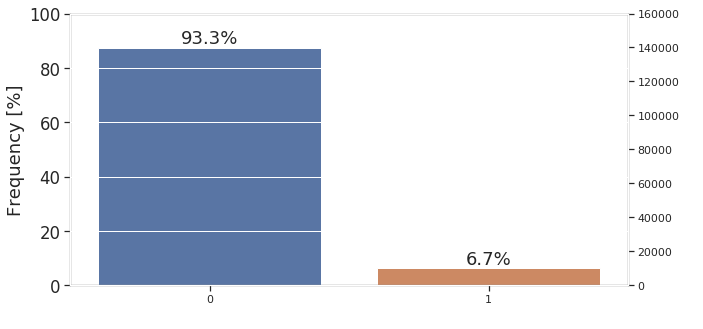

In [20]:
ax = sns.countplot(x = train_df.dlq_2yrs)
sns.set(font_scale=1.5)
ax.set_ylim(top = 150000)
ax.set_xlabel(' ')
ax.set_ylabel(' ')
fig = plt.gcf()
fig.set_size_inches(10,5)
ax.set_ylim(top=160000)

add_freq()

plt.show()

In [22]:
train_df['revolving_unsecured_lines'].value_counts()

0.000000    10878
1.000000    10256
1.000000       17
0.950100        8
0.713147        6
0.007984        6
0.954092        6
0.796407        5
0.850299        5
0.538922        5
1.003322        5
0.717131        5
0.994012        5
0.046048        5
0.582834        5
0.988024        5
0.004999        5
0.962076        4
0.003650        4
0.076923        4
0.932136        4
0.846307        4
0.930233        4
0.037498        4
0.120879        4
0.996400        4
0.001000        4
0.992016        4
0.948207        4
0.035964        4
            ...  
0.185457        1
0.240394        1
0.103126        1
0.009586        1
0.007483        1
0.243720        1
0.625282        1
0.264277        1
0.107940        1
0.478457        1
0.047742        1
0.133503        1
0.972451        1
0.110805        1
0.013018        1
0.022324        1
0.217510        1
0.020559        1
0.159196        1
0.371764        1
0.237108        1
0.924179        1
0.364635        1
0.009577        1
0.007792  

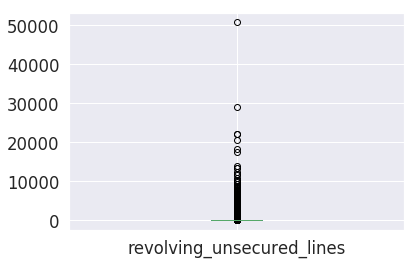

In [23]:
train_df.boxplot(column="revolving_unsecured_lines")

In [24]:
train_df['age'].value_counts()

49     3837
48     3806
50     3753
63     3719
47     3719
46     3714
53     3648
51     3627
52     3609
56     3589
62     3568
54     3561
61     3522
45     3502
58     3443
55     3416
57     3375
44     3294
59     3280
60     3258
43     3208
41     3122
40     3093
42     3082
64     3058
39     2987
38     2631
65     2594
37     2521
67     2503
       ... 
24      816
81      774
82      647
23      641
83      512
85      483
84      480
22      434
86      407
87      357
88      313
89      276
90      198
21      183
91      154
92       93
93       87
94       47
95       45
96       18
97       17
99        9
98        6
103       3
102       3
101       3
109       2
107       1
105       1
0         1
Name: age, Length: 86, dtype: int64

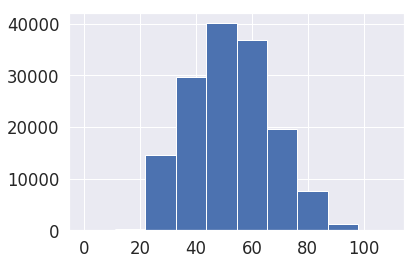

In [25]:
train_df['age'].hist()

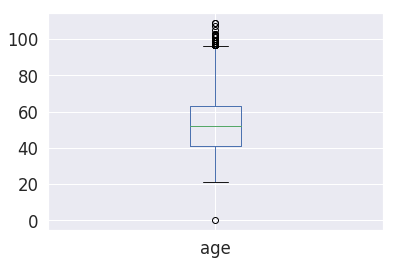

In [26]:
train_df['age'].plot.box()

In [27]:
for i in range(0,24):
    print (i, len(train_df[train_df['age'] < i]))

0 0
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
15 1
16 1
17 1
18 1
19 1
20 1
21 1
22 184
23 618


In [28]:
ageBounded = []
for val in train_df['age']:
    if val > 21:
        ageBounded.append(val)
    else:
        ageBounded.append(21)
        
train_df['age'] = ageBounded

In [29]:
ageBounded2 = []
for val in train_df['age']:
    if val < 92:
        ageBounded2.append(val)
    else:
        ageBounded2.append(92)
        
train_df['age'] = ageBounded2

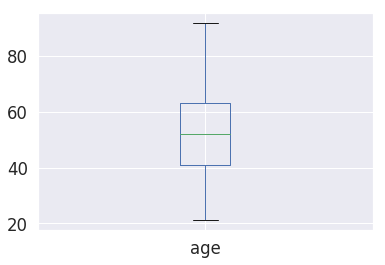

In [30]:
train_df['age'].plot.box()

In [31]:
train_df['num_30days_late'].value_counts()

0     126018
1      16033
2       4598
3       1754
4        747
5        342
98       264
6        140
7         54
8         25
9         12
96         5
10         4
12         2
13         1
11         1
Name: num_30days_late, dtype: int64

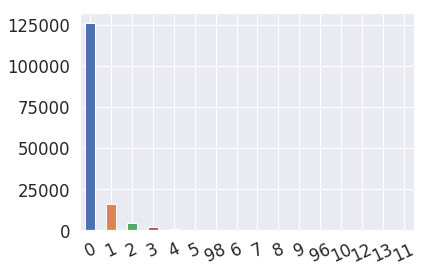

In [32]:
train_df['num_30days_late'].value_counts().plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

In [33]:
train_df['debt_ratio'].value_counts()

0.000000     4113
1.000000      229
4.000000      174
2.000000      170
3.000000      162
5.000000      143
9.000000      125
10.000000     117
7.000000      115
13.000000     114
6.000000      112
11.000000     108
8.000000      106
12.000000     102
14.000000     101
21.000000      99
15.000000      98
19.000000      91
16.000000      86
18.000000      83
20.000000      83
28.000000      80
24.000000      79
30.000000      78
25.000000      78
22.000000      78
29.000000      77
27.000000      76
23.000000      70
26.000000      69
             ... 
0.474797        1
0.508349        1
0.210872        1
0.074325        1
0.294245        1
0.230446        1
0.435326        1
0.607805        1
0.339040        1
0.558307        1
0.384478        1
1.366861        1
0.275018        1
0.909718        1
0.278574        1
0.610896        1
0.271490        1
0.336025        1
0.378557        1
0.123922        1
0.275182        1
0.174031        1
0.359255        1
0.640236        1
0.566348  

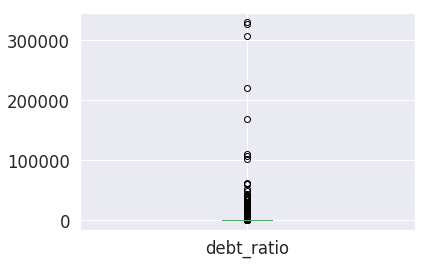

In [34]:
train_df.boxplot(column="debt_ratio")

In [35]:
train_df['monthly_inc'].value_counts()

5000.0     2757
4000.0     2106
6000.0     1934
3000.0     1758
0.0        1634
2500.0     1551
10000.0    1466
3500.0     1360
4500.0     1226
7000.0     1223
8000.0     1127
2000.0     1116
7500.0     1051
10500.0    1013
5500.0      897
6500.0      841
9000.0      763
1.0         605
3200.0      584
6250.0      570
4200.0      569
4166.0      554
1500.0      553
12000.0     547
8333.0      543
8500.0      505
3750.0      504
3600.0      503
2400.0      501
12500.0     499
           ... 
6896.0        1
3057.0        1
20283.0       1
16254.0       1
727.0         1
8405.0        1
28430.0       1
8852.0        1
7462.0        1
10224.0       1
40388.0       1
15667.0       1
6899.0        1
10099.0       1
30500.0       1
10101.0       1
25808.0       1
14803.0       1
9329.0        1
14214.0       1
16582.0       1
10105.0       1
11637.0       1
595.0         1
16580.0       1
3847.0        1
10113.0       1
14210.0       1
13023.0       1
1037.0        1
Name: monthly_inc, Lengt

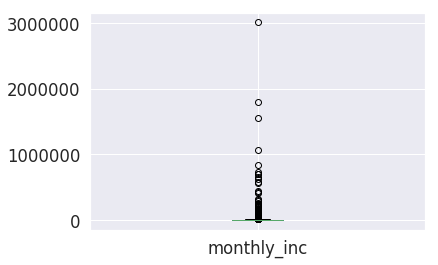

In [36]:
train_df.boxplot(column="monthly_inc")

In [37]:
train_df['num_open_credit_loans'].value_counts()

6     13614
7     13245
5     12931
8     12562
4     11609
9     11355
10     9624
3      9058
11     8321
12     7005
2      6666
13     5667
14     4546
1      4438
15     3645
16     3000
17     2370
0      1888
18     1874
19     1433
20     1169
21      864
22      685
23      533
24      422
25      337
26      239
27      194
28      150
29      114
30       88
31       74
32       52
33       47
34       35
35       27
36       18
38       13
40       10
39        9
45        8
43        8
42        8
37        7
48        6
41        4
54        4
49        4
46        3
52        3
51        2
56        2
57        2
50        2
47        2
44        2
53        1
58        1
Name: num_open_credit_loans, dtype: int64

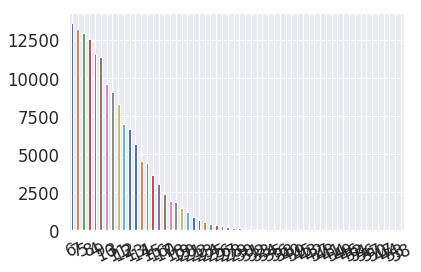

In [38]:
train_df['num_open_credit_loans'].value_counts().plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

In [39]:
train_df['num_90days_late'].value_counts()

0     141662
1       5243
2       1555
3        667
4        291
98       264
5        131
6         80
7         38
8         21
9         19
10         8
11         5
96         5
13         4
12         2
14         2
15         2
17         1
Name: num_90days_late, dtype: int64

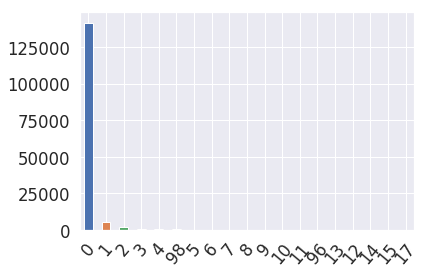

In [40]:
train_df['num_90days_late'].value_counts().plot(kind='bar')
plt.xticks(rotation=50)
plt.show()

In [41]:
train_df['num_real_estate_loans'].value_counts()

0     56188
1     52338
2     31522
3      6300
4      2170
5       689
6       320
7       171
8        93
9        78
10       37
11       23
12       18
13       15
14        7
15        7
16        4
17        4
25        3
18        2
19        2
20        2
23        2
32        1
21        1
26        1
29        1
54        1
Name: num_real_estate_loans, dtype: int64

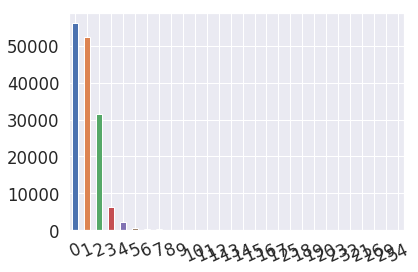

In [42]:
train_df['num_real_estate_loans'].value_counts().plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

In [43]:
train_df['num_60days_late'].value_counts()

0     142396
1       5731
2       1118
3        318
98       264
4        105
5         34
6         16
7          9
96         5
8          2
11         1
9          1
Name: num_60days_late, dtype: int64

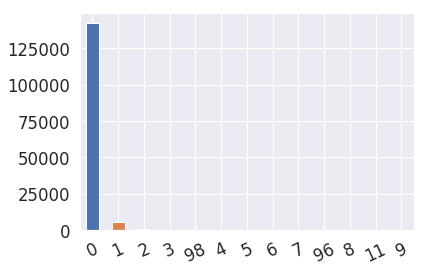

In [44]:
train_df['num_60days_late'].value_counts().plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

In [45]:
train_df['num_dependents'].value_counts()

0.0     86902
1.0     26316
2.0     19522
3.0      9483
4.0      2862
5.0       746
6.0       158
7.0        51
8.0        24
9.0         5
10.0        5
13.0        1
20.0        1
Name: num_dependents, dtype: int64

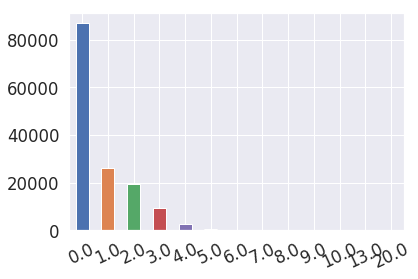

In [46]:
train_df['num_dependents'].value_counts().plot(kind='bar')
plt.xticks(rotation=25)
plt.show()

Pairplot

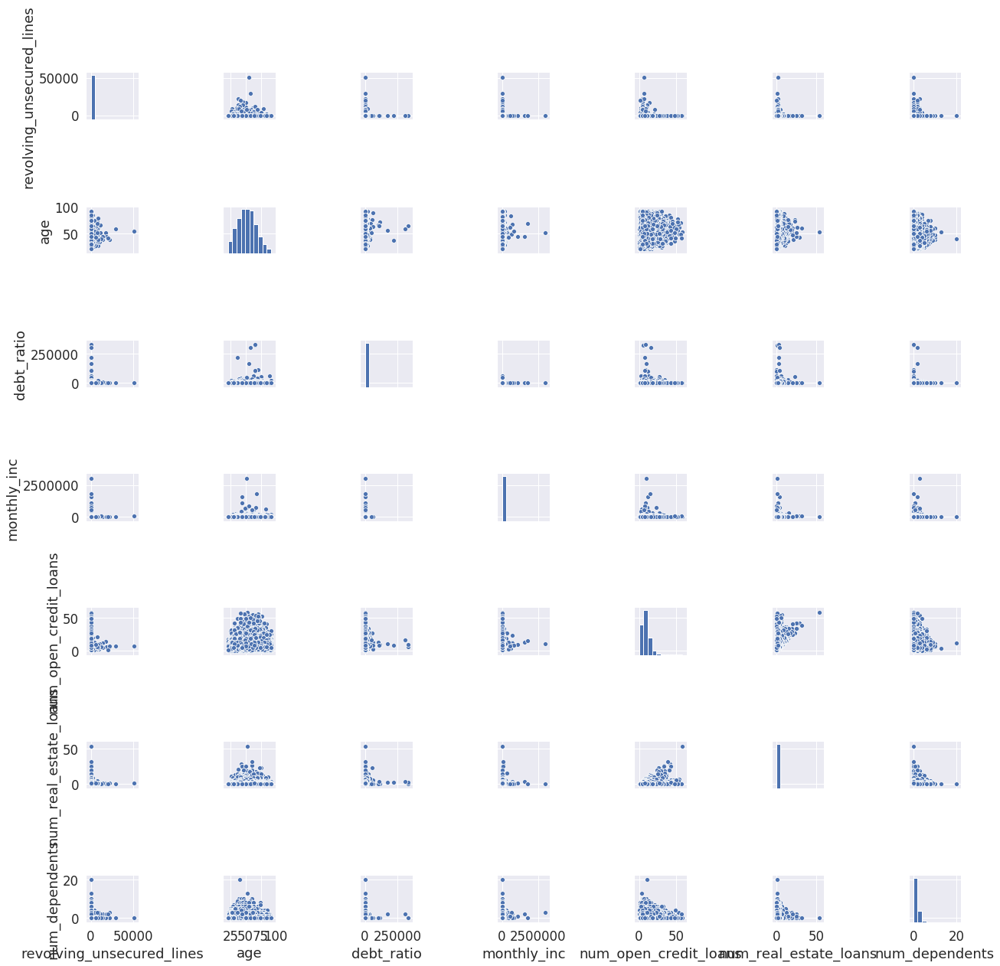

In [50]:
pairplot_df = train_df.filter(['revolving_unsecured_lines', 'age', 'debt_ratio', 
                               'monthly_inc', 'num_open_credit_loans',
                               'num_real_estate_loans', 'num_dependents'], axis=1)
sns.pairplot(pairplot_df)

In [51]:
corr_matrix = pairplot_df.corr()
corr_matrix

,revolving_unsecured_lines,age,debt_ratio,monthly_inc,num_open_credit_loans,num_real_estate_loans,num_dependents
revolving_unsecured_lines,1.000000,-0.005896,0.003961,0.007124,-0.011281,0.006235,0.001557
age,-0.005896,1.000000,0.024232,0.037756,0.148029,0.033428,-0.213300
debt_ratio,0.003961,0.024232,1.000000,-0.028712,0.049565,0.120046,-0.040673
monthly_inc,0.007124,0.037756,-0.028712,1.000000,0.091455,0.124959,0.062647
num_open_credit_loans,-0.011281,0.148029,0.049565,0.091455,1.000000,0.433959,0.065322
num_real_estate_loans,0.006235,0.033428,0.120046,0.124959,0.433959,1.000000,0.124684
num_dependents,0.001557,-0.213300,-0.040673,0.062647,0.065322,0.124684,1.000000


<a id='ads'></a>
## 3. ADS Analysis

[back to TOC](#TOC)

### Accuracy (4.a.) and Fairness Metrics (4.b.) of the ADS across different subpopulations

In [110]:
# The winning model was the rf with n_estimators=7 and max_depth=13 on the dataset removed_debt_outliers
dfus = pd.read_csv("data/removed_debt_outliers.csv", header=0)

X_train, X_test, y_train, y_test = train_test_split(
    dfus.drop("SeriousDlqin2yrs", axis=1),
    dfus["SeriousDlqin2yrs"], test_size=0.2, random_state=0)

i = 7
j = 13
rfc = RandomForestClassifier(n_estimators=i , max_depth = j, random_state=0)

fit_rfc = rfc.fit(X_train, y_train)

print('--- Test AUC ---')
y_pred_proba = rfc.predict_proba(X_test)[:,1]
print(roc_auc_score(y_test, y_pred_proba))

y_pred = rfc.predict(X_test)

def cm_print(y_test, y_pred):
    
    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()

    print('--- Confusion Matrix ---')
    print(cm)
    print('--- Accuracy ---')
    print((TP+TN)/sum(sum(cm)))
    print('--- FPR ---')
    print(FP/(FP+TN))
    print('--- PPV ---')
    print(TP/(TP+FP))
    print('--- NPV ---')
    print(TN/(TN+FN))

cm_print(y_test, y_pred)

--- Test AUC ---
0.859321746295675
--- Confusion Matrix ---
[[26971   289]
 [ 1619   371]]
--- Accuracy ---
0.9347692307692308
--- FPR ---
0.010601614086573735
--- PPV ---
0.5621212121212121
--- NPV ---
0.943371808324589


Now, let's see for subgroups:

### Age:

In [111]:
age_thr=25
privileged = X_test['age'] > age_thr
unprivileged = X_test['age'] <= age_thr

In [112]:
cm_print(y_test[unprivileged], y_pred[unprivileged])

--- Confusion Matrix ---
[[574   9]
 [ 42  10]]
--- Accuracy ---
0.9196850393700787
--- FPR ---
0.015437392795883362
--- PPV ---
0.5263157894736842
--- NPV ---
0.9318181818181818


In [113]:
cm_print(y_test[privileged], y_pred[privileged])

--- Confusion Matrix ---
[[26397   280]
 [ 1577   361]]
--- Accuracy ---
0.935103966451162
--- FPR ---
0.010495932826029914
--- PPV ---
0.5631825273010921
--- NPV ---
0.9436262243511833


#### Disparate Impact
The ideal value of this metric is 1.0 A value < 1 implies higher benefit for the privileged group and a value >1 implies a higher benefit for the unprivileged group.
Fairness for this metric is between 0.8 and 1.2.

In [114]:
selection_rate_privileged = sum(y_test[privileged]) / len(y_test[privileged])
selection_rate_unprivileged = sum(y_test[unprivileged]) / len(y_test[unprivileged])
print("--- Disparate Impact wrt Age ---")
print(selection_rate_unprivileged/selection_rate_privileged)

--- Disparate Impact wrt Age ---
1.2091205317601554


#### Statistical Parity Difference
The ideal value of this metric is 0.
Fairness for this metric is between -0.1 and 0.1.

In [115]:
print("--- Statistical Parity Difference wrt Age ---")
print(selection_rate_unprivileged - selection_rate_privileged)

--- Statistical Parity Difference wrt Age ---
0.014163047022581907


#### Equal Opportunity Difference
The ideal value is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group.
Fairness for this metric is between -0.1 and 0.1.

In [116]:
TN_p, FP_p, FN_p, TP_p = confusion_matrix(y_test[privileged], y_test[privileged]).ravel()
TN_u, FP_u, FN_u, TP_u = confusion_matrix(y_test[unprivileged], y_pred[unprivileged]).ravel()
print("--- Equal Opportunity Difference wrt Age ---")
print(TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p) )

--- Equal Opportunity Difference wrt Age ---
-0.8076923076923077


#### Average Odds Difference
The ideal value of this metric is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group.
Fairness for this metric is between -0.1 and 0.1.

In [117]:
print("--- Average Odds Difference wrt Age ---")
print(0.5*(FP_u/(FP_u+TN_u) - FP_p/(FP_p+TN_p) + 
           TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p) ))

--- Average Odds Difference wrt Age ---
-0.39612745744821215


## No. Dependents

In [118]:
X_test.NumberOfDependents.describe()

count    29250.000000
mean         0.747214
std          1.117050
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         10.000000
Name: NumberOfDependents, dtype: float64

In [119]:
childr_thr=1
privileged = X_test['NumberOfDependents'] < childr_thr
unprivileged = X_test['NumberOfDependents'] >= childr_thr

cm_print(y_test[unprivileged], y_pred[unprivileged])

--- Confusion Matrix ---
[[10514   152]
 [  759   185]]
--- Accuracy ---
0.9215331610680448
--- FPR ---
0.014250890680667542
--- PPV ---
0.5489614243323442
--- NPV ---
0.9326709837665218


In [120]:
cm_print(y_test[privileged], y_pred[privileged])

--- Confusion Matrix ---
[[16457   137]
 [  860   186]]
--- Accuracy ---
0.9434807256235828
--- FPR ---
0.008255996143184284
--- PPV ---
0.5758513931888545
--- NPV ---
0.9503378183288098


In [121]:
selection_rate_privileged = sum(y_test[privileged]) / len(y_test[privileged])
selection_rate_unprivileged = sum(y_test[unprivileged]) / len(y_test[unprivileged])
print("--- Disparate Impact wrt No. Dependants ---")
print(selection_rate_unprivileged/selection_rate_privileged)

--- Disparate Impact wrt No. Dependants ---
1.3712185216476203


In [122]:
print("--- Statistical Parity Difference wrt No. Dependants ---")
print(selection_rate_unprivileged - selection_rate_privileged)

--- Statistical Parity Difference wrt No. Dependants ---
0.022012164038742114


In [123]:
print("--- Equal Opportunity Difference wrt No. Dependants ---")
print(TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p))

--- Equal Opportunity Difference wrt No. Dependants ---
-0.8076923076923077


In [124]:
TN_p, FP_p, FN_p, TP_p = confusion_matrix(y_test[privileged], y_test[privileged]).ravel()
TN_u, FP_u, FN_u, TP_u = confusion_matrix(y_test[unprivileged], y_pred[unprivileged]).ravel()
print("--- Average Odds Difference wrt No. Dependants ---")
print(0.5*(FP_u/(FP_u+TN_u) - FP_p/(FP_p+TN_p) + 
           TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p)))

--- Average Odds Difference wrt No. Dependants ---
-0.394887266524073


## Additional methods for analyzing ADS performance (4.c.)

### USE ELi5 FOR PERMUTATION IMPORTANCE

In [125]:
from platform import python_version
print(python_version())
#running virtual environment (eli5 not functional with Python 3.7

3.6.8


In [126]:
features = X_train.columns.tolist()

perm_train = PermutationImportance(rfc, random_state=1).fit(X_train, y_train)
eli5.show_weights(perm_train, feature_names=features)

Weight,Feature
0.0201 ± 0.0003,NumberOfTimes90DaysLate
0.0158 ± 0.0005,RevolvingUtilizationOfUnsecuredLines
0.0100 ± 0.0003,DebtRatio
0.0098 ± 0.0003,NumberOfTime30-59DaysPastDueNotWorse
0.0094 ± 0.0003,NumberOfTime60-89DaysPastDueNotWorse
0.0093 ± 0.0003,age
0.0074 ± 0.0005,MonthlyIncome
0.0073 ± 0.0003,NumberOfOpenCreditLinesAndLoans
0.0038 ± 0.0002,NumberRealEstateLoansOrLines
0.0029 ± 0.0004,NumberOfDependents


In [127]:
perm_test = PermutationImportance(rfc, random_state=1).fit(X_test, y_test)
eli5.show_weights(perm_test, feature_names=features)

Weight,Feature
0.0073 ± 0.0003,NumberOfTimes90DaysLate
0.0027 ± 0.0009,RevolvingUtilizationOfUnsecuredLines
0.0019 ± 0.0001,NumberOfTime60-89DaysPastDueNotWorse
0.0018 ± 0.0009,age
0.0016 ± 0.0003,NumberOfTime30-59DaysPastDueNotWorse
0.0013 ± 0.0008,DebtRatio
0.0007 ± 0.0004,MonthlyIncome
0.0004 ± 0.0008,NumberOfDependents
0.0003 ± 0.0008,NumberOfOpenCreditLinesAndLoans
0.0003 ± 0.0004,NumberRealEstateLoansOrLines


We observe little disparity betweent the permutation importance of the train and test sets.

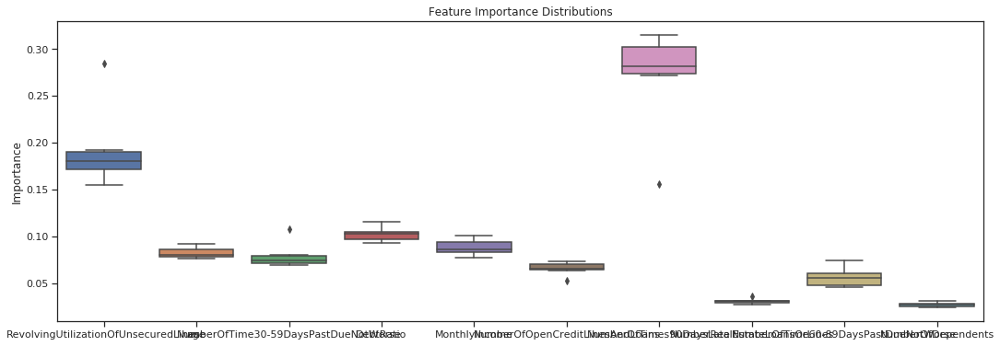

In [128]:
# get the feature importances from each tree and then visualize the
# distributions as boxplots
all_feat_imp_df = pd.DataFrame(data=[tree.feature_importances_ for tree in 
                                     rfc],
                               columns=features)

plt.figure(figsize=(18, 6))
(sns.boxplot(data=all_feat_imp_df)
        .set(title='Feature Importance Distributions',
             ylabel='Importance'));

### USE LIME FOR INSTANCE AND MODEL EXPLANATIONS

In [129]:
#already created array with predicted probabilities
y_pred_proba
len(y_pred_proba)
y_pred_proba[88]
y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [130]:
#already created array with predicted y values (turn into np array)
y_pred = np.array(y_pred)

#create array with actual y values
y_actual = np.array(y_test)
y_actual

array([0, 0, 0, ..., 0, 0, 0])

In [131]:
#load class names for explanations
class_names = ['not dlq', 'yes dlq']
labels = class_names
le= sklearn.preprocessing.LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_
le_label_mapping = dict(zip(le.classes_, le.transform(le.classes_)))

In [132]:
labels
le_label_mapping

{'not dlq': 0, 'yes dlq': 1}

In [133]:
class_names[y_test.values[30]]

'yes dlq'

In [134]:
from sklearn.pipeline import make_pipeline

sklearn.metrics.f1_score(y_actual, y_pred, average='binary')

#create a combined array to hold my 0 and 1 class tuples
dlq_proba = rfc.predict_proba(X_test)[:,1]
notdlq_proba = rfc.predict_proba(X_test)[:,0]
proba_tuples = list(zip(notdlq_proba, dlq_proba))
proba_tuples
#proba_tuples[0][1]

[(0.9785704524974959, 0.021429547502504163),
 (0.9571395740901566, 0.04286042590984327),
 (0.8684090774472416, 0.1315909225527583),
 (0.8493845318580879, 0.15061546814191207),
 (0.991673332240944, 0.008326667759055885),
 (0.996065036118201, 0.003934963881798962),
 (0.8855922761984737, 0.11440772380152626),
 (0.974097944061295, 0.025902055938705076),
 (0.9949635212000006, 0.005036478799999328),
 (0.9904090565784542, 0.009590943421545761),
 (0.9144278482845538, 0.08557215171544609),
 (0.9258022940657173, 0.07419770593428274),
 (0.991651775639626, 0.008348224360373963),
 (0.9966769651007341, 0.003323034899265715),
 (0.9592483947818758, 0.04075160521812423),
 (0.977355905865996, 0.02264409413400397),
 (0.9929207509825663, 0.007079249017433771),
 (0.9865195771432776, 0.013480422856722395),
 (0.95605406561681, 0.043945934383189986),
 (0.984274954438064, 0.015725045561935855),
 (0.9253160482599123, 0.0746839517400877),
 (0.9758450179814161, 0.02415498201858388),
 (0.9184154381916569, 0.081584

In [135]:
random_state=0

num_features = len(features)
#create LIME explainer object

explainer = LimeTabularExplainer(X_train.values, mode = 'regression',
                                            feature_names = features,
                                            class_names=class_names,
                                            categorical_features = [1],
                                            random_state=random_state,
                                            categorical_names = ['SeriousDlqin2yrs'], 
                                            discretize_continuous = False)

In [136]:
#create my predict function to pass in explainer instance
predict_fn = lambda x: rfc.predict_proba(x)[:,1].astype(float)

Document id: 150
Probability(delinquent) = 0.00970873129169609
True class: not dlq


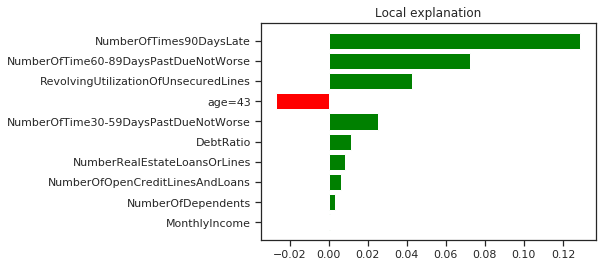

In [137]:
#try out explaining a row
exp_idx = 150
#import imp
#imp.reload(pd)
exp = explainer.explain_instance(X_test.iloc[exp_idx,:].values, predict_fn, num_features=num_features)
print('Document id: %d' % exp_idx)
print('Probability(delinquent) =', proba_tuples[exp_idx][1])
print('True class: %s' % class_names[y_test.values[exp_idx]])
exp.as_pyplot_figure();
exp.show_in_notebook()

In [138]:
exp.local_pred[0]

0.371386159955262

In [139]:
exp.intercept[0]

0.39005781784722265

In [144]:
#explain random 100 cases
import random

for i in range(0,100):
    x = random.randint(1,len(y_actual))
    exp_idx = x
    exp = explainer.explain_instance(X_test.iloc[exp_idx,:].values, predict_fn, num_features=num_features)
    print('Document id: %d' % exp_idx)
    print('Probability(delinquent) =', proba_tuples[exp_idx][1])
    print('True class: %s' % class_names[y_test.values[exp_idx]])

Document id: 18815
Probability(delinquent) = 0.00891275161250293
True class: not dlq
Document id: 15610
Probability(delinquent) = 0.13881010848492475
True class: not dlq
Document id: 27640
Probability(delinquent) = 0.02078975401465039
True class: not dlq
Document id: 19562
Probability(delinquent) = 0.01570482347668446
True class: not dlq
Document id: 5027
Probability(delinquent) = 0.9117640692640693
True class: yes dlq
Document id: 14461
Probability(delinquent) = 0.05915722475840785
True class: not dlq
Document id: 24295
Probability(delinquent) = 0.004939188853339054
True class: not dlq
Document id: 12859
Probability(delinquent) = 0.0039989916692727175
True class: not dlq
Document id: 9956
Probability(delinquent) = 0.015840418435174284
True class: not dlq
Document id: 769
Probability(delinquent) = 0.009720137263381532
True class: not dlq
Document id: 12612
Probability(delinquent) = 0.08116346844934685
True class: not dlq
Document id: 559
Probability(delinquent) = 0.0124057739653599
Tru

Running 100 random explainers reveals that we do have some false positives and negatives.

In [145]:
#put misclassified cases into an array
misclassified = np.where(y_actual != y_pred)
misclassified[0]
len(misclassified[0])
misclassified = np.asarray(misclassified[0])
len(misclassified)

1908

There are 1,908 misclassified documents.

0 is NOT Delinquent and 1 is Delinquent

Positive examples Predicted to be Delinquent, actually Delinquent (TP): Document 17710 Document 8599

Predicted to be NOT Delinquent, actually NOT Delinquent (TN): Document 15945 Document 9446

Negative examples: Predicted to be NOT Delinquent, actually Delinquent (FN): Document 3842 Document 10858

Predicted to be Delinquent, actually NOT Delinquent (FP): Document 7515 Document 16339

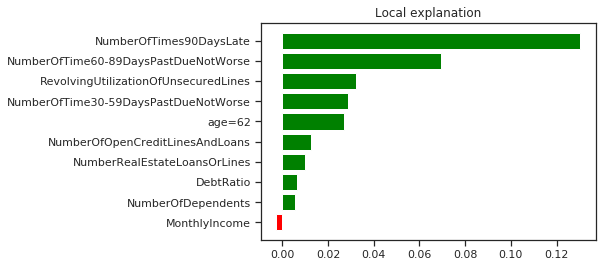

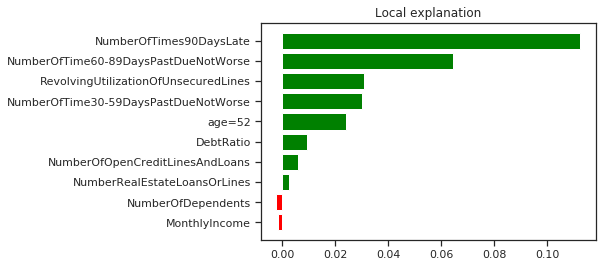

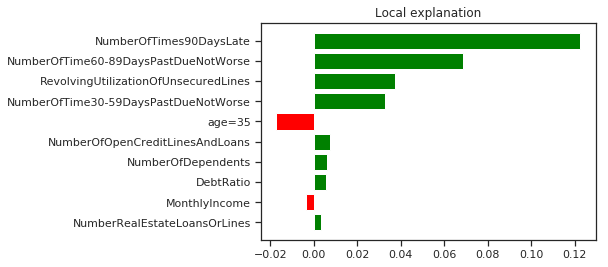

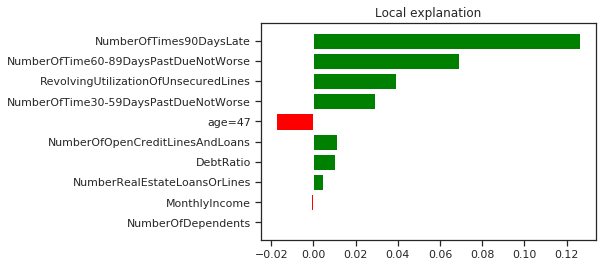

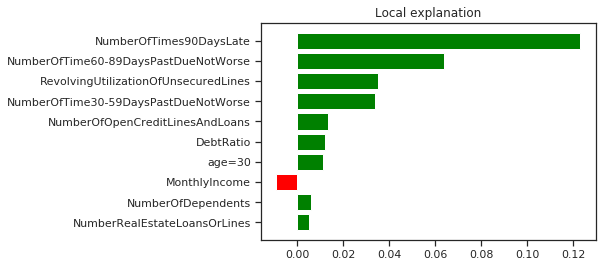

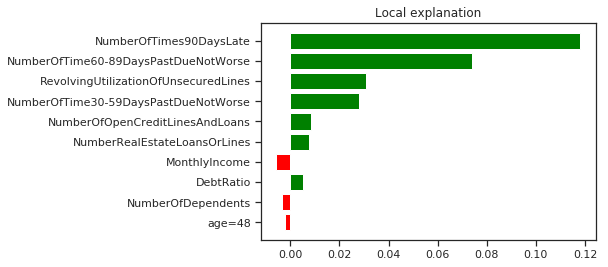

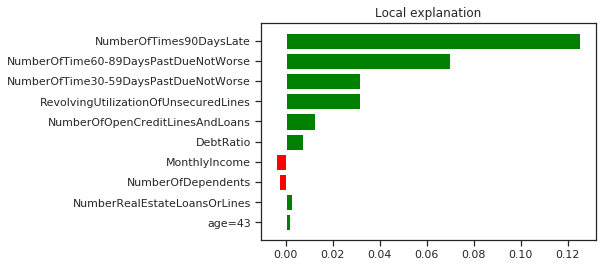

In [147]:
#here are 7 picks that represent TP, FP, TN, and FN
misc_picks = [17710,8599,15945,3842,10858,7515,16339]

%matplotlib inline
    
for i in range(len(misc_picks)):
    exp = explainer.explain_instance(X_test.iloc[misc_picks[i],:].values, predict_fn, num_features=num_features)
    fig = exp.as_pyplot_figure()
    exp.as_list()
    exp.show_in_notebook()

In [148]:
exp.save_to_file('data/misc_exs.html')

In [149]:
#calculate magnitude of error

conf_arr = []

for i in range(len(misclassified)):
    exp = explainer.explain_instance(X_test.iloc[misclassified[i],:].values, predict_fn, num_features=5)
    print('Document id: %d' % misclassified[i])
    #conf = c.predict_proba(X_test.iloc[misclassified[i],:].values)[0]
    #conf_diff = abs(conf[0] - conf[1])
    conf_diff = abs(proba_tuples[misclassified[i]][0] - proba_tuples[misclassified[i]][1])
    conf_arr.append(conf_diff)
    print('True class: %s' % class_names[y_test.values[misclassified[i]]])
    print('Probability difference =', conf_diff)
#create array from values
print (conf_arr)

Document id: 22
True class: yes dlq
Probability difference = 0.836830876383314
Document id: 30
True class: yes dlq
Probability difference = 0.887300458332744
Document id: 65
True class: not dlq
Probability difference = 0.37155367894284147
Document id: 70
True class: yes dlq
Probability difference = 0.045145330859616584
Document id: 73
True class: yes dlq
Probability difference = 0.9521364312201507
Document id: 84
True class: not dlq
Probability difference = 0.07224489795918371
Document id: 100
True class: yes dlq
Probability difference = 0.1446234318449548
Document id: 116
True class: yes dlq
Probability difference = 0.6253713470653928
Document id: 137
True class: yes dlq
Probability difference = 0.8147137570455762
Document id: 149
True class: yes dlq
Probability difference = 0.9375679794091452
Document id: 169
True class: yes dlq
Probability difference = 0.9818765002908225
Document id: 199
True class: yes dlq
Probability difference = 0.4349727129488261
Document id: 200
True class: yes

Document id: 1499
True class: yes dlq
Probability difference = 0.5985148724680227
Document id: 1501
True class: not dlq
Probability difference = 0.1111111111111111
Document id: 1511
True class: yes dlq
Probability difference = 0.26125722031225784
Document id: 1542
True class: yes dlq
Probability difference = 0.9642751714122021
Document id: 1547
True class: yes dlq
Probability difference = 0.9004661897431046
Document id: 1566
True class: yes dlq
Probability difference = 0.9867930554426217
Document id: 1574
True class: yes dlq
Probability difference = 0.4903890871153525
Document id: 1576
True class: yes dlq
Probability difference = 0.9703877751557101
Document id: 1624
True class: yes dlq
Probability difference = 0.64421768707483
Document id: 1675
True class: yes dlq
Probability difference = 0.8648938971140132
Document id: 1676
True class: yes dlq
Probability difference = 0.944997897299584
Document id: 1729
True class: yes dlq
Probability difference = 0.7017552602422439
Document id: 1749


Document id: 3076
True class: yes dlq
Probability difference = 0.5947161770691183
Document id: 3078
True class: yes dlq
Probability difference = 0.8196828703436297
Document id: 3080
True class: yes dlq
Probability difference = 0.8800934025386179
Document id: 3081
True class: yes dlq
Probability difference = 0.7338691294631637
Document id: 3085
True class: not dlq
Probability difference = 0.09956192554893378
Document id: 3135
True class: yes dlq
Probability difference = 0.8711130135885583
Document id: 3145
True class: yes dlq
Probability difference = 0.07401487694277553
Document id: 3150
True class: yes dlq
Probability difference = 0.8554292460785967
Document id: 3176
True class: yes dlq
Probability difference = 0.9152936846720988
Document id: 3186
True class: not dlq
Probability difference = 0.2737861199525682
Document id: 3202
True class: yes dlq
Probability difference = 0.9012472356204515
Document id: 3272
True class: yes dlq
Probability difference = 0.20498229856081251
Document id: 

Document id: 4664
True class: yes dlq
Probability difference = 0.8097051366197155
Document id: 4683
True class: yes dlq
Probability difference = 0.9866966980415189
Document id: 4689
True class: yes dlq
Probability difference = 0.9491322046264073
Document id: 4695
True class: yes dlq
Probability difference = 0.9131071059035483
Document id: 4720
True class: yes dlq
Probability difference = 0.7009966777408638
Document id: 4723
True class: not dlq
Probability difference = 0.36888147897181206
Document id: 4727
True class: yes dlq
Probability difference = 0.03557717660707699
Document id: 4730
True class: yes dlq
Probability difference = 0.17981743415889745
Document id: 4736
True class: yes dlq
Probability difference = 0.44083326596060046
Document id: 4750
True class: yes dlq
Probability difference = 0.38579585214592654
Document id: 4758
True class: yes dlq
Probability difference = 0.8638660565302209
Document id: 4759
True class: yes dlq
Probability difference = 0.36736385351686685
Document i

Document id: 6072
True class: yes dlq
Probability difference = 0.9627349146961405
Document id: 6085
True class: yes dlq
Probability difference = 0.25019984640416104
Document id: 6094
True class: yes dlq
Probability difference = 0.8115728285428836
Document id: 6105
True class: yes dlq
Probability difference = 0.5782868085073969
Document id: 6111
True class: not dlq
Probability difference = 0.14285714285714285
Document id: 6126
True class: yes dlq
Probability difference = 0.9213301341639297
Document id: 6133
True class: yes dlq
Probability difference = 0.8336653076142361
Document id: 6134
True class: yes dlq
Probability difference = 0.883605349124069
Document id: 6146
True class: yes dlq
Probability difference = 0.5493180862458031
Document id: 6152
True class: yes dlq
Probability difference = 0.8943349339202556
Document id: 6163
True class: yes dlq
Probability difference = 0.25340934915922697
Document id: 6192
True class: yes dlq
Probability difference = 0.9688250198877824
Document id: 6

Document id: 7855
True class: yes dlq
Probability difference = 0.9349726406691303
Document id: 7862
True class: not dlq
Probability difference = 0.008343055838231084
Document id: 7880
True class: yes dlq
Probability difference = 0.8317756307334909
Document id: 7891
True class: yes dlq
Probability difference = 0.4812220673604255
Document id: 7928
True class: yes dlq
Probability difference = 0.3587019882819135
Document id: 7947
True class: yes dlq
Probability difference = 0.3902260416380192
Document id: 7952
True class: yes dlq
Probability difference = 0.9391224621263239
Document id: 7970
True class: yes dlq
Probability difference = 0.7815137487689704
Document id: 7972
True class: yes dlq
Probability difference = 0.9068167949848339
Document id: 8009
True class: yes dlq
Probability difference = 0.6915235128319241
Document id: 8043
True class: yes dlq
Probability difference = 0.14233645944320067
Document id: 8053
True class: yes dlq
Probability difference = 0.640576406028237
Document id: 8

Document id: 9425
True class: yes dlq
Probability difference = 0.9701411689457091
Document id: 9442
True class: yes dlq
Probability difference = 0.6260033263659216
Document id: 9453
True class: not dlq
Probability difference = 0.037508804334742074
Document id: 9456
True class: yes dlq
Probability difference = 0.7975447463592117
Document id: 9459
True class: yes dlq
Probability difference = 0.7431453184728386
Document id: 9481
True class: yes dlq
Probability difference = 0.24984683922864614
Document id: 9487
True class: yes dlq
Probability difference = 0.9782469134754266
Document id: 9499
True class: yes dlq
Probability difference = 0.320951988697803
Document id: 9501
True class: not dlq
Probability difference = 0.23660036738546103
Document id: 9527
True class: yes dlq
Probability difference = 0.8085837502498933
Document id: 9536
True class: yes dlq
Probability difference = 0.8594016320625659
Document id: 9539
True class: yes dlq
Probability difference = 0.23311137343136018
Document id:

Document id: 10858
True class: yes dlq
Probability difference = 0.3594761540980029
Document id: 10883
True class: yes dlq
Probability difference = 0.543897620392866
Document id: 10891
True class: yes dlq
Probability difference = 0.6913110868107819
Document id: 10893
True class: yes dlq
Probability difference = 0.5455832307746674
Document id: 10903
True class: yes dlq
Probability difference = 0.681733065874758
Document id: 10908
True class: yes dlq
Probability difference = 0.9108489807453684
Document id: 10909
True class: yes dlq
Probability difference = 0.272332498419455
Document id: 10926
True class: yes dlq
Probability difference = 0.5854875283446712
Document id: 10943
True class: yes dlq
Probability difference = 0.5912695966068078
Document id: 10973
True class: yes dlq
Probability difference = 0.045744281964754496
Document id: 10989
True class: not dlq
Probability difference = 0.3510007796867077
Document id: 10996
True class: yes dlq
Probability difference = 0.8099503713538394
Docum

Document id: 12155
True class: yes dlq
Probability difference = 0.08034802961498344
Document id: 12180
True class: not dlq
Probability difference = 0.11193901052425637
Document id: 12215
True class: yes dlq
Probability difference = 0.14004933504933503
Document id: 12227
True class: yes dlq
Probability difference = 0.24593538607867754
Document id: 12251
True class: yes dlq
Probability difference = 0.8709072329787947
Document id: 12262
True class: yes dlq
Probability difference = 0.9177340211488408
Document id: 12266
True class: yes dlq
Probability difference = 0.2596276952948473
Document id: 12274
True class: yes dlq
Probability difference = 0.15290254877153253
Document id: 12319
True class: yes dlq
Probability difference = 0.813888734267667
Document id: 12354
True class: yes dlq
Probability difference = 0.7705901255550649
Document id: 12362
True class: yes dlq
Probability difference = 0.6694501420741259
Document id: 12363
True class: yes dlq
Probability difference = 0.10343172792846339

Document id: 13723
True class: yes dlq
Probability difference = 0.40112044817927184
Document id: 13727
True class: yes dlq
Probability difference = 0.9704708740336915
Document id: 13728
True class: yes dlq
Probability difference = 0.9865950652056397
Document id: 13739
True class: yes dlq
Probability difference = 0.35714285714285715
Document id: 13748
True class: yes dlq
Probability difference = 0.9752913517671512
Document id: 13777
True class: yes dlq
Probability difference = 0.9348203674384713
Document id: 13818
True class: yes dlq
Probability difference = 0.3602800103707546
Document id: 13846
True class: yes dlq
Probability difference = 0.7666528067339344
Document id: 13849
True class: yes dlq
Probability difference = 0.5710572972867377
Document id: 13864
True class: yes dlq
Probability difference = 0.737239830257769
Document id: 13872
True class: yes dlq
Probability difference = 0.6878368677511049
Document id: 13888
True class: yes dlq
Probability difference = 0.5533411943562014
Doc

Document id: 15204
True class: yes dlq
Probability difference = 0.5952419828795138
Document id: 15221
True class: yes dlq
Probability difference = 0.8433302788852681
Document id: 15239
True class: yes dlq
Probability difference = 0.27014218009478674
Document id: 15249
True class: not dlq
Probability difference = 0.02040816326530609
Document id: 15282
True class: yes dlq
Probability difference = 0.8686371407114155
Document id: 15324
True class: yes dlq
Probability difference = 0.845472844225449
Document id: 15355
True class: yes dlq
Probability difference = 0.9778187938778747
Document id: 15356
True class: not dlq
Probability difference = 0.12767905581204814
Document id: 15366
True class: yes dlq
Probability difference = 0.8708395770247735
Document id: 15382
True class: not dlq
Probability difference = 0.07629150912858784
Document id: 15416
True class: yes dlq
Probability difference = 0.7838533471386465
Document id: 15484
True class: yes dlq
Probability difference = 0.9663889218548198
D

Document id: 16689
True class: not dlq
Probability difference = 0.2947186147186149
Document id: 16700
True class: yes dlq
Probability difference = 0.5380689439941864
Document id: 16701
True class: yes dlq
Probability difference = 0.9876422158893434
Document id: 16725
True class: yes dlq
Probability difference = 0.7439107705077174
Document id: 16744
True class: yes dlq
Probability difference = 0.9124776600685837
Document id: 16759
True class: yes dlq
Probability difference = 0.94236570171858
Document id: 16760
True class: yes dlq
Probability difference = 0.21859440054268792
Document id: 16765
True class: yes dlq
Probability difference = 0.7838908480818916
Document id: 16771
True class: yes dlq
Probability difference = 0.3462856270933907
Document id: 16806
True class: yes dlq
Probability difference = 0.9253272220901216
Document id: 16843
True class: yes dlq
Probability difference = 0.9877777267030238
Document id: 16856
True class: yes dlq
Probability difference = 0.21067176870748305
Docu

Document id: 18435
True class: yes dlq
Probability difference = 0.49272385282142234
Document id: 18444
True class: yes dlq
Probability difference = 0.8846491019258422
Document id: 18552
True class: yes dlq
Probability difference = 0.8731305175386961
Document id: 18563
True class: not dlq
Probability difference = 0.6100571088258129
Document id: 18580
True class: yes dlq
Probability difference = 0.899624211924247
Document id: 18586
True class: yes dlq
Probability difference = 0.48755274261603376
Document id: 18606
True class: not dlq
Probability difference = 0.3023611164896066
Document id: 18615
True class: yes dlq
Probability difference = 0.9726282876631047
Document id: 18634
True class: yes dlq
Probability difference = 0.7142857142857142
Document id: 18655
True class: yes dlq
Probability difference = 0.897328317419264
Document id: 18663
True class: yes dlq
Probability difference = 0.7107421202077394
Document id: 18678
True class: yes dlq
Probability difference = 0.38188910417534083
Doc

Document id: 20292
True class: yes dlq
Probability difference = 0.6733422189440635
Document id: 20320
True class: yes dlq
Probability difference = 0.4367693995133758
Document id: 20321
True class: yes dlq
Probability difference = 0.9304492521754321
Document id: 20329
True class: yes dlq
Probability difference = 0.6080800920390772
Document id: 20357
True class: yes dlq
Probability difference = 0.8173001777974859
Document id: 20362
True class: yes dlq
Probability difference = 0.8501672523368409
Document id: 20382
True class: yes dlq
Probability difference = 0.8587471402386476
Document id: 20390
True class: yes dlq
Probability difference = 0.3157762082283609
Document id: 20392
True class: not dlq
Probability difference = 0.18368642038303995
Document id: 20394
True class: yes dlq
Probability difference = 0.391682831581589
Document id: 20423
True class: not dlq
Probability difference = 0.6200043653825167
Document id: 20436
True class: yes dlq
Probability difference = 0.9310223561358403
Docu

Document id: 21741
True class: not dlq
Probability difference = 0.4901960784313726
Document id: 21746
True class: yes dlq
Probability difference = 0.27076089750017446
Document id: 21754
True class: yes dlq
Probability difference = 0.7158098394934412
Document id: 21759
True class: yes dlq
Probability difference = 0.3240112130605001
Document id: 21816
True class: yes dlq
Probability difference = 0.7148042593189985
Document id: 21819
True class: yes dlq
Probability difference = 0.33841682127396416
Document id: 21825
True class: not dlq
Probability difference = 0.8337236533957846
Document id: 21874
True class: yes dlq
Probability difference = 0.5965969964042587
Document id: 21883
True class: yes dlq
Probability difference = 0.8659079999344017
Document id: 21907
True class: yes dlq
Probability difference = 0.9328736569107917
Document id: 21950
True class: yes dlq
Probability difference = 0.4072806381435824
Document id: 21970
True class: yes dlq
Probability difference = 0.6472438406255265
Do

Document id: 23484
True class: yes dlq
Probability difference = 0.3694651221144196
Document id: 23502
True class: yes dlq
Probability difference = 0.49179344109829115
Document id: 23511
True class: yes dlq
Probability difference = 0.8670690103225844
Document id: 23550
True class: yes dlq
Probability difference = 0.6362362129386125
Document id: 23554
True class: yes dlq
Probability difference = 0.9410467976907289
Document id: 23562
True class: not dlq
Probability difference = 0.15594594411042811
Document id: 23576
True class: yes dlq
Probability difference = 0.924856245203912
Document id: 23579
True class: yes dlq
Probability difference = 0.7713290726322513
Document id: 23583
True class: yes dlq
Probability difference = 0.6149606391316046
Document id: 23614
True class: yes dlq
Probability difference = 0.7033570733285681
Document id: 23616
True class: yes dlq
Probability difference = 0.9327646113491446
Document id: 23618
True class: yes dlq
Probability difference = 0.8907925228256007
Doc

Document id: 25031
True class: yes dlq
Probability difference = 0.727292180652866
Document id: 25034
True class: yes dlq
Probability difference = 0.9708048678651906
Document id: 25039
True class: yes dlq
Probability difference = 0.9216283691307158
Document id: 25046
True class: yes dlq
Probability difference = 0.18850323717580347
Document id: 25054
True class: yes dlq
Probability difference = 0.968652255933707
Document id: 25089
True class: yes dlq
Probability difference = 0.8912312822184162
Document id: 25090
True class: not dlq
Probability difference = 0.3523242630385488
Document id: 25105
True class: not dlq
Probability difference = 0.19681293762926422
Document id: 25128
True class: yes dlq
Probability difference = 0.4514699218031331
Document id: 25135
True class: yes dlq
Probability difference = 0.9344348887984238
Document id: 25145
True class: yes dlq
Probability difference = 0.40501934905539316
Document id: 25154
True class: yes dlq
Probability difference = 0.8703078547749551
Doc

Document id: 26453
True class: yes dlq
Probability difference = 0.8362666560421007
Document id: 26482
True class: yes dlq
Probability difference = 0.11168831168831167
Document id: 26540
True class: not dlq
Probability difference = 0.05888215208944725
Document id: 26549
True class: yes dlq
Probability difference = 0.8109424805555481
Document id: 26551
True class: yes dlq
Probability difference = 0.959360532937454
Document id: 26552
True class: yes dlq
Probability difference = 0.6762860072676387
Document id: 26557
True class: yes dlq
Probability difference = 0.9538240416515851
Document id: 26584
True class: yes dlq
Probability difference = 0.3685094878770769
Document id: 26595
True class: not dlq
Probability difference = 0.7036709420610349
Document id: 26596
True class: yes dlq
Probability difference = 0.1743172923626377
Document id: 26611
True class: yes dlq
Probability difference = 0.16050486019074028
Document id: 26634
True class: yes dlq
Probability difference = 0.19826832802627564
D

Document id: 27833
True class: yes dlq
Probability difference = 0.8765873729978291
Document id: 27841
True class: yes dlq
Probability difference = 0.8947657697952742
Document id: 27891
True class: yes dlq
Probability difference = 0.30760210335294835
Document id: 27895
True class: yes dlq
Probability difference = 0.22874117949760708
Document id: 27901
True class: not dlq
Probability difference = 0.32124305111796864
Document id: 27942
True class: not dlq
Probability difference = 0.06466147723911692
Document id: 27944
True class: yes dlq
Probability difference = 0.8509054241148136
Document id: 27951
True class: yes dlq
Probability difference = 0.6015999880466149
Document id: 27961
True class: yes dlq
Probability difference = 0.9216553503489646
Document id: 27982
True class: yes dlq
Probability difference = 0.8526288762814065
Document id: 27983
True class: yes dlq
Probability difference = 0.6678206164202884
Document id: 27984
True class: yes dlq
Probability difference = 0.7276311794691642


In [150]:
#plot

mag_error = pd.DataFrame(conf_arr)
mag_error.columns = ['dist_error']
mag_error

misclassified_df = pd.DataFrame(misclassified)
misclassified_df.columns = ['doc_id']
misclassified_df

misclassified_df['dist_error'] = mag_error['dist_error']
misclassified_df

,doc_id,dist_error
0,22,0.836831
1,30,0.887300
2,65,0.371554
3,70,0.045145
4,73,0.952136
5,84,0.072245
6,100,0.144623
7,116,0.625371
8,137,0.814714
9,149,0.937568


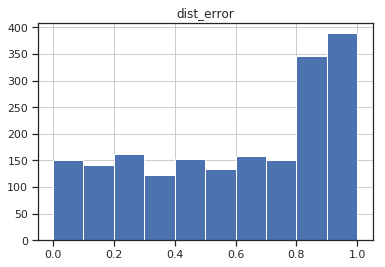

In [151]:
error_distribution = misclassified_df.hist('dist_error',bins=10)

In [152]:
#select representative cases
import warnings
from lime import submodular_pick

In [153]:
sp_obj = submodular_pick.SubmodularPick(explainer, X_train.values, predict_fn, sample_size=10, num_features=num_features, num_exps_desired=10)
#sp_obj.V

In [154]:
for idx in sp_obj.V:
    exp = explainer.explain_instance(X_test.values[idx], predict_fn, num_features=5)
    print("Actual class: ", y_test.iloc[idx])
    exp.show_in_notebook(show_all=False)
    #exp.as_list()

Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


In [155]:
sub_pick_df=pd.DataFrame([dict(this.as_list()) for this in sp_obj.explanations])
sub_pick_df.head()

,DebtRatio,MonthlyIncome,NumberOfDependents,NumberOfOpenCreditLinesAndLoans,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTime60-89DaysPastDueNotWorse,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,RevolvingUtilizationOfUnsecuredLines,age=41,age=46,age=51,age=54,age=56,age=58,age=59,age=65,age=68,age=84
0,-0.001291,-0.002371,0.001855,0.010711,0.028753,0.068549,0.138175,0.009337,0.045530,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.021291,NaN
1,0.008960,-0.005841,0.004947,0.007325,0.031945,0.069869,0.120789,0.006503,0.038282,NaN,-0.007716,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.006111,-0.005123,0.003459,0.010632,0.029850,0.072829,0.123292,0.005958,0.038124,NaN,NaN,0.04459,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.007931,0.001327,0.001157,0.007998,0.035073,0.070393,0.124878,0.013987,0.035636,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.06043
4,0.005655,-0.006368,0.004619,0.008408,0.031883,0.071999,0.120030,0.003937,0.030592,-0.027488,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


---
This kernel has been released under the [Apache 2.0](http://www.apache.org/licenses/LICENSE-2.0) open source license.
<a id='EOF'></a>

[back to TOC](#TOC)